In [2]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from pathlib2 import Path

In [3]:
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [4]:
# Root directory for dataset
dataroot = 'data/celeba'

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 16

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 400

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 128

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

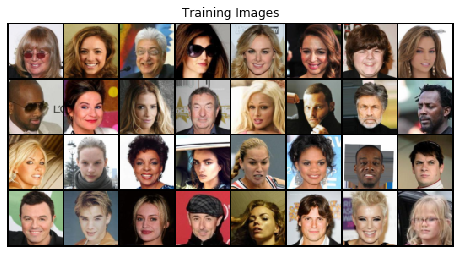

In [5]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [24]:
os.getcwd()

'C:\\Users\\georg\\.fyp'

In [8]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [6]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [9]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(128, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [10]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [12]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [13]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [14]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/5][0/6332]	Loss_D: 1.8282	Loss_G: 3.4023	D(x): 0.3208	D(G(z)): 0.3582 / 0.0360
[0/5][50/6332]	Loss_D: 0.0612	Loss_G: 15.8615	D(x): 0.9591	D(G(z)): 0.0001 / 0.0000
[0/5][100/6332]	Loss_D: 0.1853	Loss_G: 15.5764	D(x): 0.9122	D(G(z)): 0.0000 / 0.0000
[0/5][150/6332]	Loss_D: 0.6455	Loss_G: 13.9981	D(x): 0.9621	D(G(z)): 0.3943 / 0.0000
[0/5][200/6332]	Loss_D: 0.4433	Loss_G: 8.1929	D(x): 0.7492	D(G(z)): 0.0035 / 0.0018
[0/5][250/6332]	Loss_D: 0.7430	Loss_G: 5.9219	D(x): 0.9660	D(G(z)): 0.4437 / 0.0056
[0/5][300/6332]	Loss_D: 0.7002	Loss_G: 10.0292	D(x): 0.9238	D(G(z)): 0.3957 / 0.0002
[0/5][350/6332]	Loss_D: 2.0991	Loss_G: 10.7690	D(x): 0.9605	D(G(z)): 0.7838 / 0.0001
[0/5][400/6332]	Loss_D: 0.3846	Loss_G: 5.7059	D(x): 0.8924	D(G(z)): 0.1872 / 0.0064
[0/5][450/6332]	Loss_D: 0.3658	Loss_G: 4.9586	D(x): 0.8905	D(G(z)): 0.1563 / 0.0128
[0/5][500/6332]	Loss_D: 0.9501	Loss_G: 2.5330	D(x): 0.6109	D(G(z)): 0.1435 / 0.1384
[0/5][550/6332]	Loss_D: 0.3981	Loss_G: 4.4681	D(

[0/5][4850/6332]	Loss_D: 0.5557	Loss_G: 2.9003	D(x): 0.8382	D(G(z)): 0.2399 / 0.0863
[0/5][4900/6332]	Loss_D: 0.6448	Loss_G: 3.1401	D(x): 0.6902	D(G(z)): 0.1554 / 0.0636
[0/5][4950/6332]	Loss_D: 1.2279	Loss_G: 6.1746	D(x): 0.9014	D(G(z)): 0.6009 / 0.0036
[0/5][5000/6332]	Loss_D: 0.8302	Loss_G: 1.5011	D(x): 0.5657	D(G(z)): 0.1339 / 0.2823
[0/5][5050/6332]	Loss_D: 0.4427	Loss_G: 3.9563	D(x): 0.8752	D(G(z)): 0.2171 / 0.0263
[0/5][5100/6332]	Loss_D: 0.3964	Loss_G: 1.8298	D(x): 0.7683	D(G(z)): 0.0817 / 0.2033
[0/5][5150/6332]	Loss_D: 0.7620	Loss_G: 1.1347	D(x): 0.5865	D(G(z)): 0.0622 / 0.3861
[0/5][5200/6332]	Loss_D: 0.7662	Loss_G: 1.1495	D(x): 0.5628	D(G(z)): 0.0391 / 0.3606
[0/5][5250/6332]	Loss_D: 0.5211	Loss_G: 2.6737	D(x): 0.7969	D(G(z)): 0.1991 / 0.0858
[0/5][5300/6332]	Loss_D: 0.8283	Loss_G: 3.0140	D(x): 0.6915	D(G(z)): 0.2973 / 0.0698
[0/5][5350/6332]	Loss_D: 0.3901	Loss_G: 3.4675	D(x): 0.8088	D(G(z)): 0.1148 / 0.0560
[0/5][5400/6332]	Loss_D: 0.5839	Loss_G: 4.6390	D(x): 0.9480	D(G(z

[1/5][3350/6332]	Loss_D: 0.4745	Loss_G: 1.9501	D(x): 0.7364	D(G(z)): 0.1197 / 0.1747
[1/5][3400/6332]	Loss_D: 0.5442	Loss_G: 4.8832	D(x): 0.9297	D(G(z)): 0.3453 / 0.0089
[1/5][3450/6332]	Loss_D: 0.9921	Loss_G: 1.0060	D(x): 0.5276	D(G(z)): 0.1280 / 0.4236
[1/5][3500/6332]	Loss_D: 0.5352	Loss_G: 3.4384	D(x): 0.8676	D(G(z)): 0.2765 / 0.0393
[1/5][3550/6332]	Loss_D: 0.9733	Loss_G: 5.8364	D(x): 0.9399	D(G(z)): 0.4714 / 0.0054
[1/5][3600/6332]	Loss_D: 0.5537	Loss_G: 4.8771	D(x): 0.9604	D(G(z)): 0.3613 / 0.0103
[1/5][3650/6332]	Loss_D: 0.2893	Loss_G: 3.0641	D(x): 0.9530	D(G(z)): 0.1998 / 0.0617
[1/5][3700/6332]	Loss_D: 1.0473	Loss_G: 5.5451	D(x): 0.9881	D(G(z)): 0.5345 / 0.0061
[1/5][3750/6332]	Loss_D: 0.6508	Loss_G: 5.0278	D(x): 0.9234	D(G(z)): 0.3969 / 0.0086
[1/5][3800/6332]	Loss_D: 0.3545	Loss_G: 3.8299	D(x): 0.8168	D(G(z)): 0.0961 / 0.0381
[1/5][3850/6332]	Loss_D: 0.4746	Loss_G: 3.1735	D(x): 0.7839	D(G(z)): 0.1634 / 0.0542
[1/5][3900/6332]	Loss_D: 1.0055	Loss_G: 1.5597	D(x): 0.4677	D(G(z

[2/5][1850/6332]	Loss_D: 0.8400	Loss_G: 6.5207	D(x): 0.9687	D(G(z)): 0.4799 / 0.0024
[2/5][1900/6332]	Loss_D: 0.6677	Loss_G: 5.5886	D(x): 0.9105	D(G(z)): 0.3642 / 0.0049
[2/5][1950/6332]	Loss_D: 0.3955	Loss_G: 4.2111	D(x): 0.8871	D(G(z)): 0.2084 / 0.0186
[2/5][2000/6332]	Loss_D: 0.1979	Loss_G: 3.3766	D(x): 0.8851	D(G(z)): 0.0582 / 0.0512
[2/5][2050/6332]	Loss_D: 0.7778	Loss_G: 2.0426	D(x): 0.5652	D(G(z)): 0.0549 / 0.1848
[2/5][2100/6332]	Loss_D: 0.4116	Loss_G: 3.6866	D(x): 0.8735	D(G(z)): 0.2201 / 0.0297
[2/5][2150/6332]	Loss_D: 0.2602	Loss_G: 3.7360	D(x): 0.9390	D(G(z)): 0.1600 / 0.0348
[2/5][2200/6332]	Loss_D: 0.5755	Loss_G: 5.6750	D(x): 0.9577	D(G(z)): 0.3028 / 0.0062
[2/5][2250/6332]	Loss_D: 0.2614	Loss_G: 4.3672	D(x): 0.9222	D(G(z)): 0.1391 / 0.0174
[2/5][2300/6332]	Loss_D: 0.4322	Loss_G: 2.8314	D(x): 0.7114	D(G(z)): 0.0269 / 0.0891
[2/5][2350/6332]	Loss_D: 0.3462	Loss_G: 4.5653	D(x): 0.9326	D(G(z)): 0.2125 / 0.0125
[2/5][2400/6332]	Loss_D: 0.7247	Loss_G: 1.1524	D(x): 0.6776	D(G(z

[3/5][350/6332]	Loss_D: 0.8742	Loss_G: 4.8589	D(x): 0.8743	D(G(z)): 0.4271 / 0.0144
[3/5][400/6332]	Loss_D: 0.2570	Loss_G: 3.5392	D(x): 0.8642	D(G(z)): 0.0673 / 0.0486
[3/5][450/6332]	Loss_D: 0.2394	Loss_G: 2.9729	D(x): 0.8669	D(G(z)): 0.0834 / 0.0776
[3/5][500/6332]	Loss_D: 0.1923	Loss_G: 3.5674	D(x): 0.9013	D(G(z)): 0.0752 / 0.0401
[3/5][550/6332]	Loss_D: 0.2127	Loss_G: 3.8083	D(x): 0.8596	D(G(z)): 0.0445 / 0.0401
[3/5][600/6332]	Loss_D: 0.3320	Loss_G: 3.0270	D(x): 0.8665	D(G(z)): 0.1483 / 0.0773
[3/5][650/6332]	Loss_D: 0.3992	Loss_G: 4.0889	D(x): 0.7549	D(G(z)): 0.0403 / 0.0369
[3/5][700/6332]	Loss_D: 0.1961	Loss_G: 3.9853	D(x): 0.9661	D(G(z)): 0.1331 / 0.0258
[3/5][750/6332]	Loss_D: 0.3513	Loss_G: 3.3034	D(x): 0.9030	D(G(z)): 0.1853 / 0.0522
[3/5][800/6332]	Loss_D: 0.7395	Loss_G: 3.2709	D(x): 0.7822	D(G(z)): 0.2832 / 0.0573
[3/5][850/6332]	Loss_D: 0.8829	Loss_G: 2.2902	D(x): 0.6173	D(G(z)): 0.2178 / 0.1423
[3/5][900/6332]	Loss_D: 0.3505	Loss_G: 2.7358	D(x): 0.7954	D(G(z)): 0.0803 /

[3/5][5200/6332]	Loss_D: 0.2150	Loss_G: 4.6112	D(x): 0.9204	D(G(z)): 0.1065 / 0.0178
[3/5][5250/6332]	Loss_D: 0.2934	Loss_G: 2.7197	D(x): 0.8499	D(G(z)): 0.0849 / 0.1040
[3/5][5300/6332]	Loss_D: 0.6509	Loss_G: 3.6689	D(x): 0.6213	D(G(z)): 0.0113 / 0.0619
[3/5][5350/6332]	Loss_D: 0.4614	Loss_G: 3.8283	D(x): 0.8478	D(G(z)): 0.2009 / 0.0273
[3/5][5400/6332]	Loss_D: 0.3300	Loss_G: 2.7931	D(x): 0.8481	D(G(z)): 0.0944 / 0.0807
[3/5][5450/6332]	Loss_D: 0.1352	Loss_G: 3.6338	D(x): 0.9341	D(G(z)): 0.0575 / 0.0454
[3/5][5500/6332]	Loss_D: 0.2685	Loss_G: 2.4257	D(x): 0.8582	D(G(z)): 0.0765 / 0.1285
[3/5][5550/6332]	Loss_D: 0.0587	Loss_G: 5.9362	D(x): 0.9695	D(G(z)): 0.0260 / 0.0055
[3/5][5600/6332]	Loss_D: 0.2468	Loss_G: 3.6608	D(x): 0.9534	D(G(z)): 0.1593 / 0.0385
[3/5][5650/6332]	Loss_D: 0.2758	Loss_G: 2.9192	D(x): 0.8958	D(G(z)): 0.1111 / 0.0787
[3/5][5700/6332]	Loss_D: 0.8891	Loss_G: 7.6491	D(x): 0.9216	D(G(z)): 0.4646 / 0.0009
[3/5][5750/6332]	Loss_D: 0.2001	Loss_G: 5.1914	D(x): 0.9445	D(G(z

[4/5][3700/6332]	Loss_D: 0.1443	Loss_G: 3.1273	D(x): 0.9432	D(G(z)): 0.0632 / 0.0775
[4/5][3750/6332]	Loss_D: 0.3300	Loss_G: 4.0725	D(x): 0.9733	D(G(z)): 0.2152 / 0.0260
[4/5][3800/6332]	Loss_D: 0.4469	Loss_G: 1.9492	D(x): 0.7449	D(G(z)): 0.0743 / 0.1775
[4/5][3850/6332]	Loss_D: 0.1086	Loss_G: 4.3483	D(x): 0.9879	D(G(z)): 0.0866 / 0.0235
[4/5][3900/6332]	Loss_D: 0.1174	Loss_G: 5.6785	D(x): 0.9704	D(G(z)): 0.0738 / 0.0057
[4/5][3950/6332]	Loss_D: 0.3708	Loss_G: 4.9608	D(x): 0.8857	D(G(z)): 0.1732 / 0.0096
[4/5][4000/6332]	Loss_D: 0.1538	Loss_G: 4.5546	D(x): 0.9348	D(G(z)): 0.0664 / 0.0213
[4/5][4050/6332]	Loss_D: 0.1204	Loss_G: 5.7260	D(x): 0.9442	D(G(z)): 0.0479 / 0.0075
[4/5][4100/6332]	Loss_D: 0.3985	Loss_G: 2.0385	D(x): 0.7701	D(G(z)): 0.0567 / 0.2072
[4/5][4150/6332]	Loss_D: 0.2170	Loss_G: 4.5809	D(x): 0.8405	D(G(z)): 0.0086 / 0.0190
[4/5][4200/6332]	Loss_D: 1.8928	Loss_G: 9.4567	D(x): 0.9590	D(G(z)): 0.6841 / 0.0002
[4/5][4250/6332]	Loss_D: 0.3686	Loss_G: 5.8894	D(x): 0.7682	D(G(z

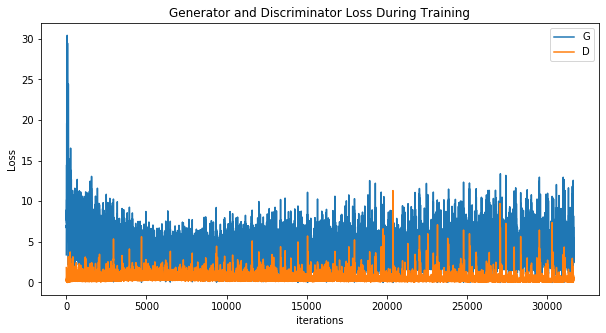

In [15]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21341684 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


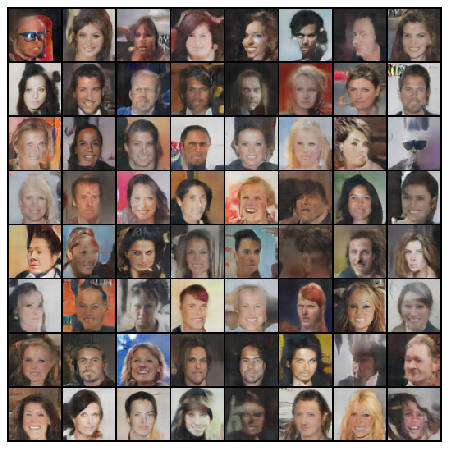

In [16]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

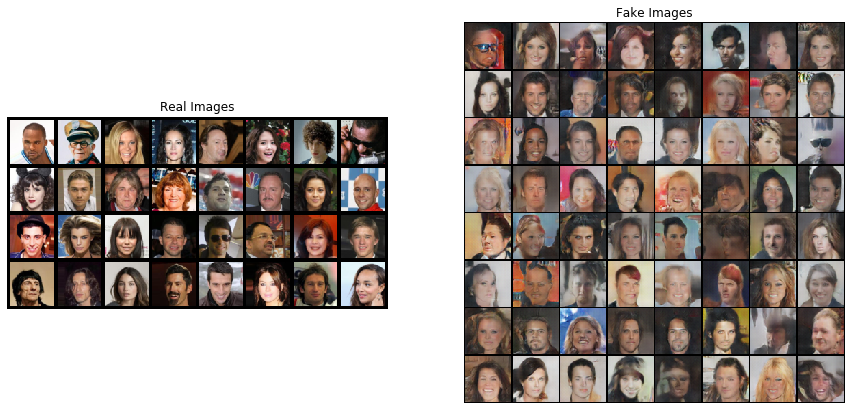

In [17]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()